In [1]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import skimage
from sklearn.cluster import KMeans

In [2]:
os.environ['PTNONINTERACTIVE'] = '1'  # suppress messages from analysator
os.environ['PTNOLATEX'] = '1'  # no latex rendering

sys.path.insert(0, '..')
sys.path.insert(0, '../analysator')

from vlsvtools import VLSVfile
import vdfplot
from misctools import rotateArrayVectorToVector
from analysator.pyCalculations.rotation import rotateArrayTensorToVector

Using backend module://matplotlib_inline.backend_inline
Using backend module://matplotlib_inline.backend_inline
Using matplotlib version 3.4.3


In [3]:
f = VLSVfile("../data/2D_magnetosphere/bulk.0004000.vlsv")

INFO:vlsvtools:Found 7200000 cells in ../data/2D_magnetosphere/bulk.0004000.vlsv
INFO:vlsvtools:Found VDF data in 2871 cells


In [4]:
# rotate V and P to magnetic field

P = rotateArrayTensorToVector(f.P, f.B)
V = rotateArrayVectorToVector(f.V, f.B)

In [5]:
df = pd.DataFrame({"cellid": f.cellids,
                   "rho": f.rho,
                   "Vx": V[:,0],    "Vy": V[:,1],    "Vz": V[:,2],
                   "Pxx": P[:,0,0], "Pxy": P[:,0,1], "Pxz": P[:,0,2],
                   "Pyy": P[:,1,1], "Pyz": P[:,1,2], "Pzz": P[:,2,2]})
df

,cellid,rho,Vx,Vy,Vz,Pxx,Pxy,Pxz,Pyy,Pyz,Pzz
0,1,1.176442e+06,249102.611924,4.151300e+04,6.255441e+05,3.913206e-11,4.881572e-12,3.086210e-12,7.642644e-12,4.674563e-13,7.198785e-12
1,2,1.176442e+06,249089.776501,4.151012e+04,6.255494e+05,3.913196e-11,4.881439e-12,3.086890e-12,7.642606e-12,4.675479e-13,7.198916e-12
2,3,1.176442e+06,249076.941021,4.150724e+04,6.255547e+05,3.913187e-11,4.881306e-12,3.087570e-12,7.642568e-12,4.676395e-13,7.199047e-12
3,4,1.184229e+06,236446.033888,2.540001e+04,6.303218e+05,4.060786e-11,4.241597e-12,3.745702e-12,7.437040e-12,4.713822e-13,7.319523e-12
4,5,1.185422e+06,230575.993645,6.599643e+03,6.327529e+05,4.084375e-11,3.479078e-12,4.183148e-12,7.259875e-12,4.287944e-13,7.418822e-12
...,...,...,...,...,...,...,...,...,...,...,...
7199995,7199996,9.999642e+05,745691.451565,-8.042481e+04,-2.812934e+03,6.903252e-12,-5.924374e-20,-5.693193e-20,6.903252e-12,4.514477e-21,6.903252e-12
7199996,7199997,1.000003e+06,748774.692027,-4.346541e+04,-2.725660e+03,6.903254e-12,-3.839005e-19,-4.765125e-21,6.903252e-12,6.880153e-22,6.903252e-12
7199997,7199998,9.996339e+05,749835.638715,-1.614947e+04,-2.470686e+03,6.903252e-12,-7.897339e-21,-5.812712e-21,6.903252e-12,1.486616e-22,6.903252e-12
7199998,7199999,1.000000e+06,-750000.000000,8.833647e-13,7.656749e-13,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00


In [6]:
# derive features p_par, p_perp and v_par, v_perp
features = ['rho', 'v_par', 'v_perp', 'p_par', 'p_perp']

df_scaled = df.copy()
df_scaled.rename(columns={'Vz': 'v_par', 'Vy': 'v_perp', 'Pzz': 'p_par'}, inplace=True)
df_scaled['p_perp'] = (df_scaled['Pxx'] + df_scaled['Pyy']) / 2

# standardize density
df_scaled['rho'] = df_scaled['rho'] / df_scaled['rho'].std()

# standardize v_par, v_perp scale, mirror negative values
v_std = np.concatenate((df_scaled['v_par'].values, df_scaled['v_perp'].values)).std()
df_scaled['v_par'] = np.abs(df_scaled['v_par'] / v_std)
df_scaled['v_perp'] = np.abs(df_scaled['v_perp'] / v_std)

# standardize p_par, p_perp scale
p_std = np.concatenate((df_scaled['p_par'].values, df_scaled['p_perp'].values)).std()
df_scaled['p_par'] = df_scaled['p_par'] / p_std
df_scaled['p_perp'] = df_scaled['p_perp'] / p_std

df_scaled[features]

,rho,v_par,v_perp,p_par,p_perp
0,1.338977,1.916376e+00,1.271765e-01,0.062761,0.203899
1,1.338977,1.916393e+00,1.271677e-01,0.062763,0.203898
2,1.338977,1.916409e+00,1.271589e-01,0.062764,0.203898
3,1.347839,1.931013e+00,7.781383e-02,0.063814,0.209436
4,1.349197,1.938460e+00,2.021824e-02,0.064680,0.209692
...,...,...,...,...,...
7199995,1.138117,8.617523e-03,2.463842e-01,0.060185,0.060185
7199996,1.138161,8.350155e-03,1.331578e-01,0.060185,0.060185
7199997,1.137741,7.569033e-03,4.947448e-02,0.060185,0.060185
7199998,1.138158,2.345672e-18,2.706219e-18,0.000000,0.000000


rho    : μ=1.220  std=1.000  range=0.000...8.880
v_par  : μ=0.971  std=0.888  range=0.000...6.172
v_perp : μ=0.236  std=0.463  range=0.000...5.655
p_par  : μ=0.523  std=0.731  range=0.000...38.014
p_perp : μ=0.748  std=1.200  range=0.000...32.528


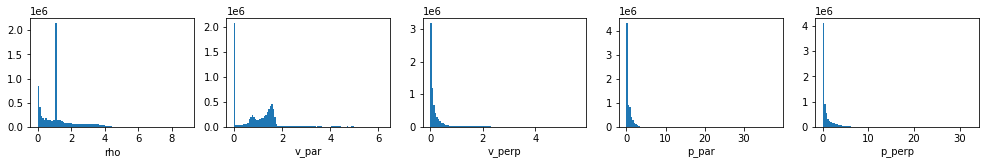

In [7]:
# inspect distributions of features

fig, ax = plt.subplots(1, 5, figsize=(17,2))
ax = ax.flatten()
ax[0].hist(df_scaled['rho'], bins=100); ax[0].set_xlabel('rho')
ax[1].hist(df_scaled['v_par'], bins=100); ax[1].set_xlabel('v_par')
ax[2].hist(df_scaled['v_perp'], bins=100); ax[2].set_xlabel('v_perp')
ax[3].hist(df_scaled['p_par'], bins=100); ax[3].set_xlabel('p_par')
ax[4].hist(df_scaled['p_perp'], bins=100); _ = ax[4].set_xlabel('p_perp')

def print_summary_statistics(feature):
    print(f'{feature:6} : μ={df_scaled[feature].mean():.3f}', end='  ')
    print(f'std={df_scaled[feature].std():.3f}', end='  ')
    print(f'range={df_scaled[feature].min():.3f}...{df_scaled[feature].max():.3f}')

for feature in features:
    print_summary_statistics(feature)

In [8]:
def kmeans(df, feature_cols, n_clusters=7):
    k = KMeans(n_clusters=n_clusters,
               tol=0, max_iter=np.iinfo(np.int64).max).fit(df[feature_cols].values)
    df[f'k{n_clusters}_class'] = k.labels_
    return (k.cluster_centers_, k.inertia_, k.n_iter_)

In [9]:
def spatial_vis(kmeans_class, xsize, ysize, color_range, cmap='plasma'):
    n_clusters = len(np.unique(kmeans_class))
    cluster_sizes = np.unique(kmeans_class, return_counts=True)[1]

    mpl_cmap = plt.get_cmap(cmap)
    mpl_norm = mpl.colors.Normalize(vmin=0, vmax=color_range-1)
    mpl_cmap_scalar = mpl.cm.ScalarMappable(norm=mpl_norm, cmap=mpl_cmap)

    colors = np.array([mpl_cmap_scalar.to_rgba(c)[:3] for c in range(color_range)])
    colors = (colors * 255).astype(np.uint8)

    def compress_colors(colors, n_clusters):
        max_c = len(colors) + 1
        n_c = n_clusters
        cen = max_c // 2
        stride = max_c // n_c
        l = int(n_c % 2 == max_c % 2) * int(max_c > n_c) + int(n_c % 2 == (max_c-1) % 2 == 0)
        r = int(n_c % 2 != max_c % 2) * int(max_c > n_c)
        w = (n_c // 2) * (max_c // n_c)
        return colors[cen-w-1+l:cen+w+1-r:stride]

    colors = compress_colors(colors, n_clusters)
    colors = colors[np.argsort(cluster_sizes)]

    rgb_image = colors[kmeans_class]
    rgb_image = rgb_image.reshape((xsize, ysize, 3))

    return rgb_image

In [10]:
max_clusters = 12
loss_vals = np.zeros(max_clusters-1)
centroid_vals = {}
images = {}
xsize, ysize, zsize = f.mesh_size

for n_clusters in range(2, max_clusters+1):
    n_data = len(df_scaled)
    n_feat = len(features)
    print(f'Computing k-means for {n_clusters} clusters ({n_feat} features, {n_data} datapoints)...')
    centroids, loss, iters = kmeans(df_scaled, features, n_clusters=n_clusters)
    loss_vals[n_clusters-2] = loss
    centroid_vals[n_clusters] = centroids
    print(f'Took {iters} iterations. loss = {loss:.3f}')
    images[n_clusters] = spatial_vis(df_scaled[f'k{n_clusters}_class'].values,
                         color_range=max_clusters,
                         xsize=zsize, ysize=xsize)

Computing k-means for 2 clusters (5 features, 7200000 datapoints)...
Took 16 iterations. loss = 14272338.856
Computing k-means for 3 clusters (5 features, 7200000 datapoints)...
Took 33 iterations. loss = 10208150.530
Computing k-means for 4 clusters (5 features, 7200000 datapoints)...
Took 79 iterations. loss = 8081963.221
Computing k-means for 5 clusters (5 features, 7200000 datapoints)...
Took 55 iterations. loss = 6327931.771
Computing k-means for 6 clusters (5 features, 7200000 datapoints)...
Took 39 iterations. loss = 5021604.625
Computing k-means for 7 clusters (5 features, 7200000 datapoints)...
Took 59 iterations. loss = 4255614.708
Computing k-means for 8 clusters (5 features, 7200000 datapoints)...
Took 79 iterations. loss = 3675639.774
Computing k-means for 9 clusters (5 features, 7200000 datapoints)...
Took 106 iterations. loss = 3301259.471
Computing k-means for 10 clusters (5 features, 7200000 datapoints)...
Took 84 iterations. loss = 2961955.918
Computing k-means for 11

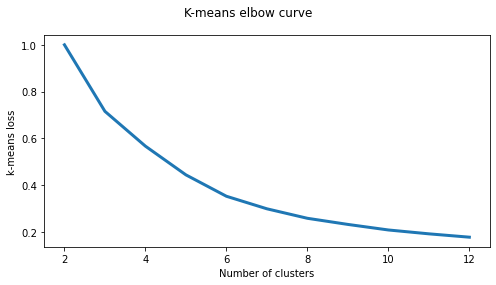

In [11]:
loss_vals = loss_vals / loss_vals.max()
fig, ax = plt.subplots(figsize=(7, 4))
plt.suptitle('K-means elbow curve')
ax.set_xlabel('Number of clusters')
ax.set_ylabel('k-means loss')
ax.plot(range(2, max_clusters+1), loss_vals, lw=3)
plt.tight_layout()
plt.savefig('../output/2D_magnetosphere/images/kmeans/2D_kmeans_elbow.png', dpi=300)

In [12]:
for n_clusters, image in images.items():
    if not os.path.exists(f'../output/2D_magnetosphere/images/kmeans/{n_clusters}class'):
        os.makedirs(f'../output/2D_magnetosphere/images/kmeans/{n_clusters}class')
    skimage.io.imsave(f'../output/2D_magnetosphere/images/kmeans/{n_clusters}class/kmeans.png', image)

In [13]:
def find_prototype_cells(cellids, features, centroids):
    assert len(cellids) == len(features)
    prototype_ids = []
    for c in centroids:
        idx = np.argmin(np.linalg.norm(features - c, axis=1))
        prototype_ids.append(cellids[idx])
    return np.array(prototype_ids)

Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs


c:\Users\makes\codes\plasma-dsp2022\experiments\..\vdfplot.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(2, 2, figsize=(15, 15))


Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for population avgs
Getting offsets for populati

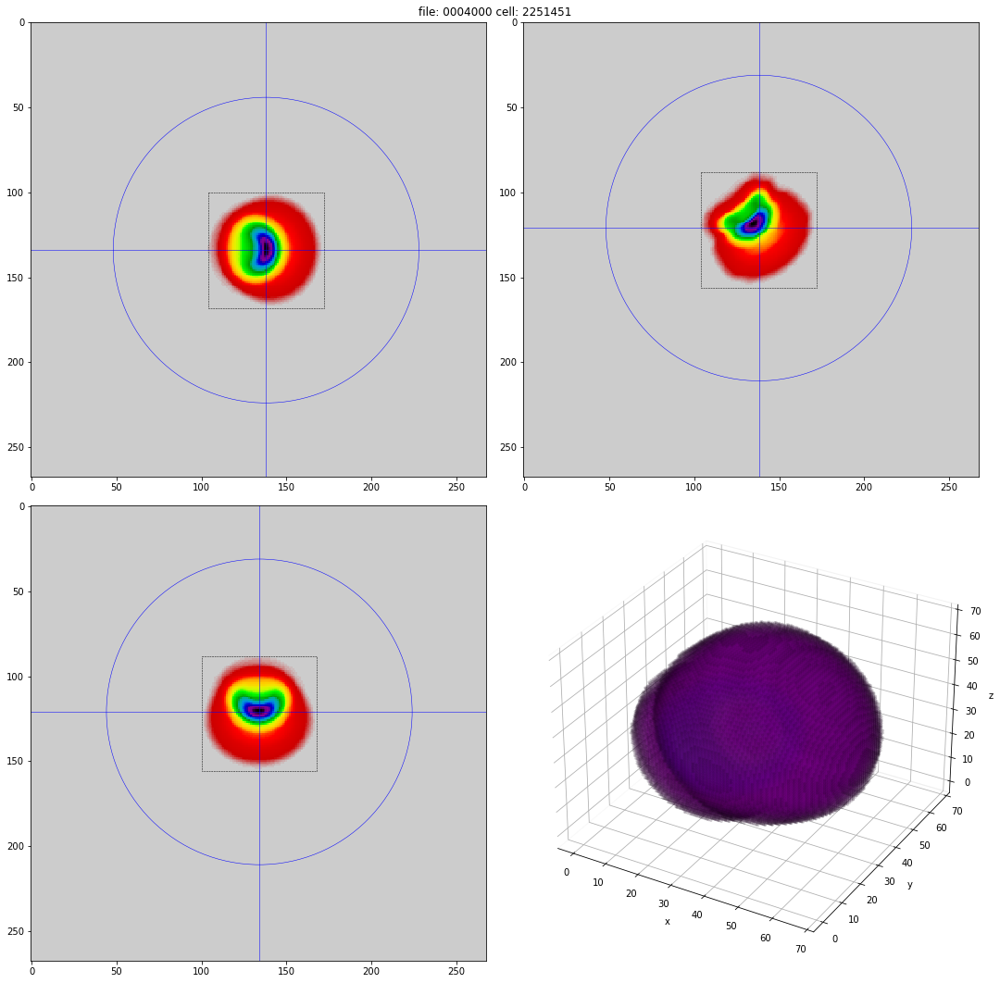

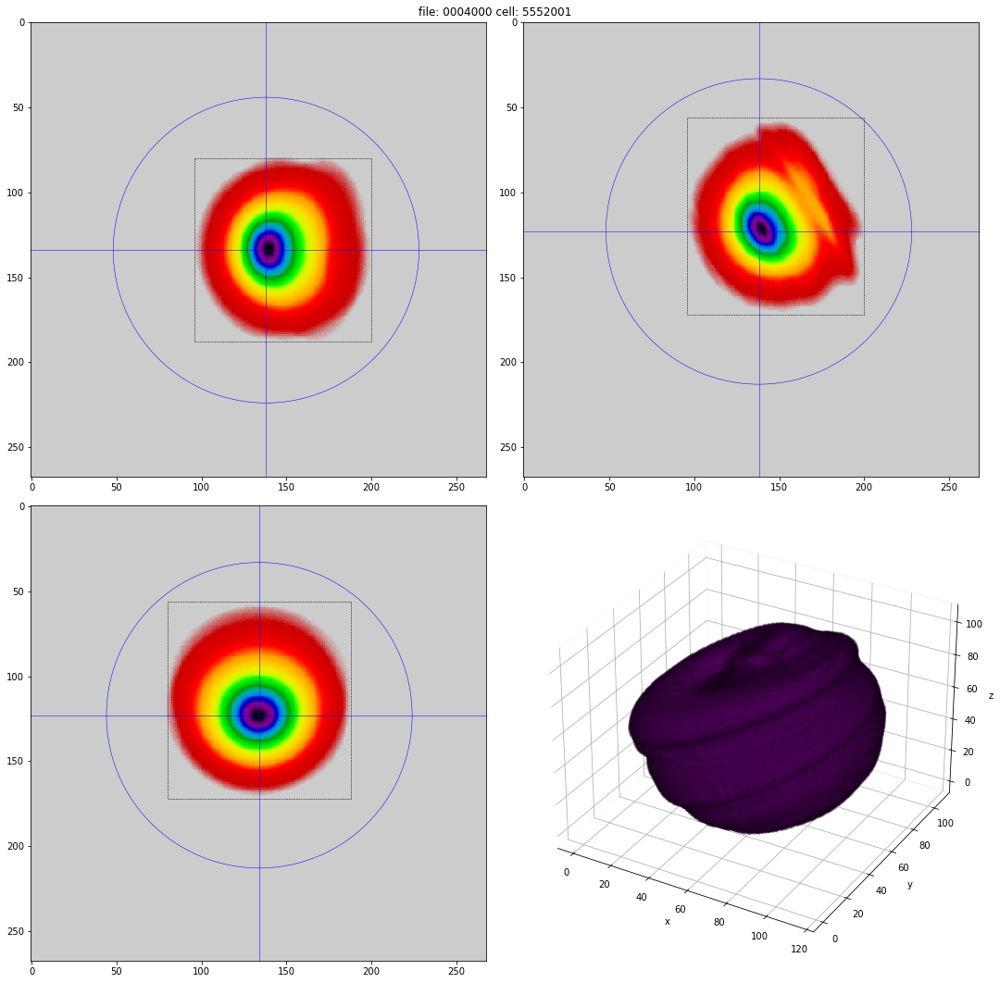

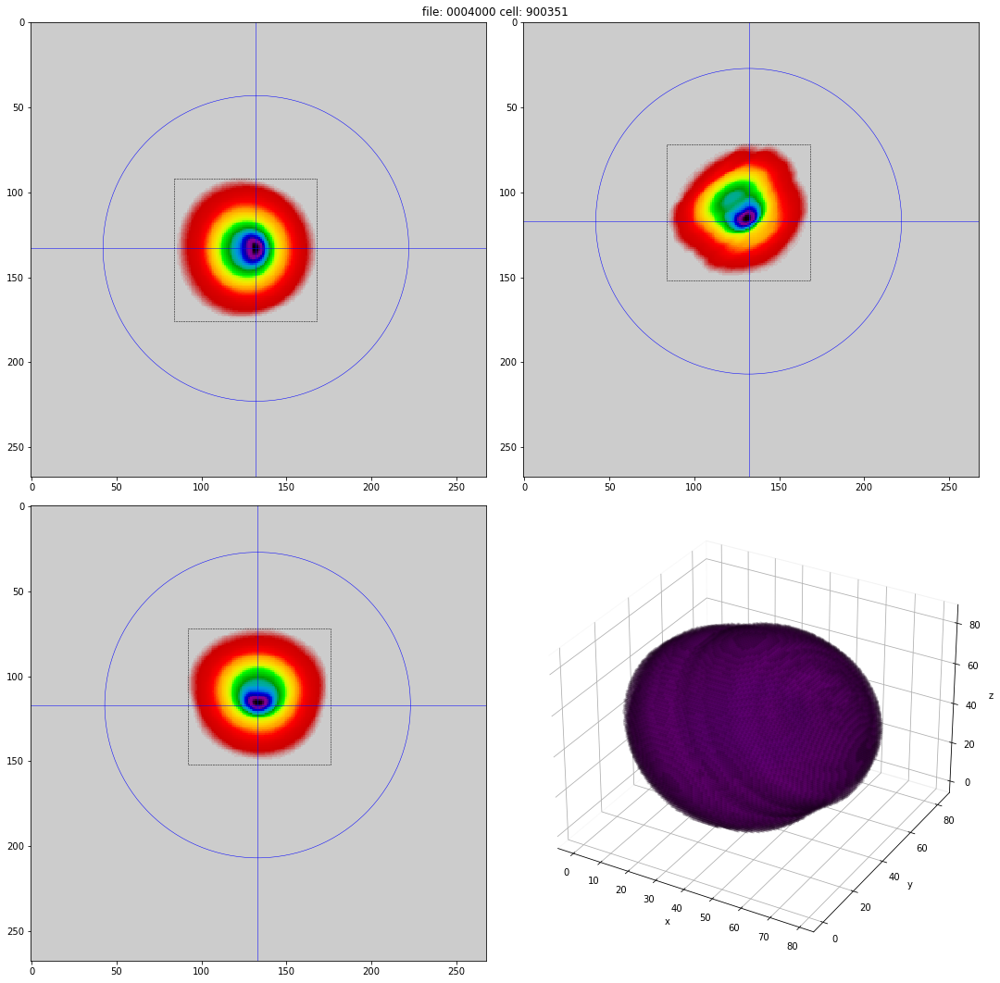

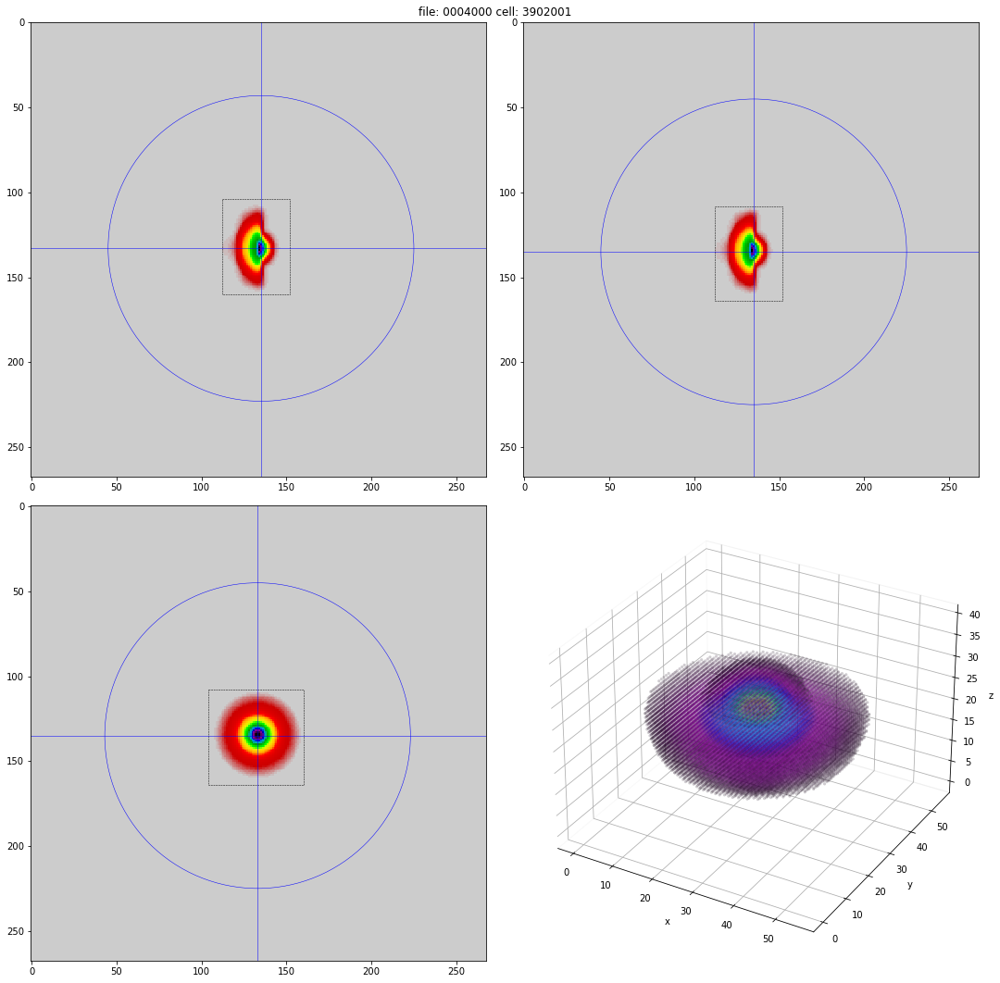

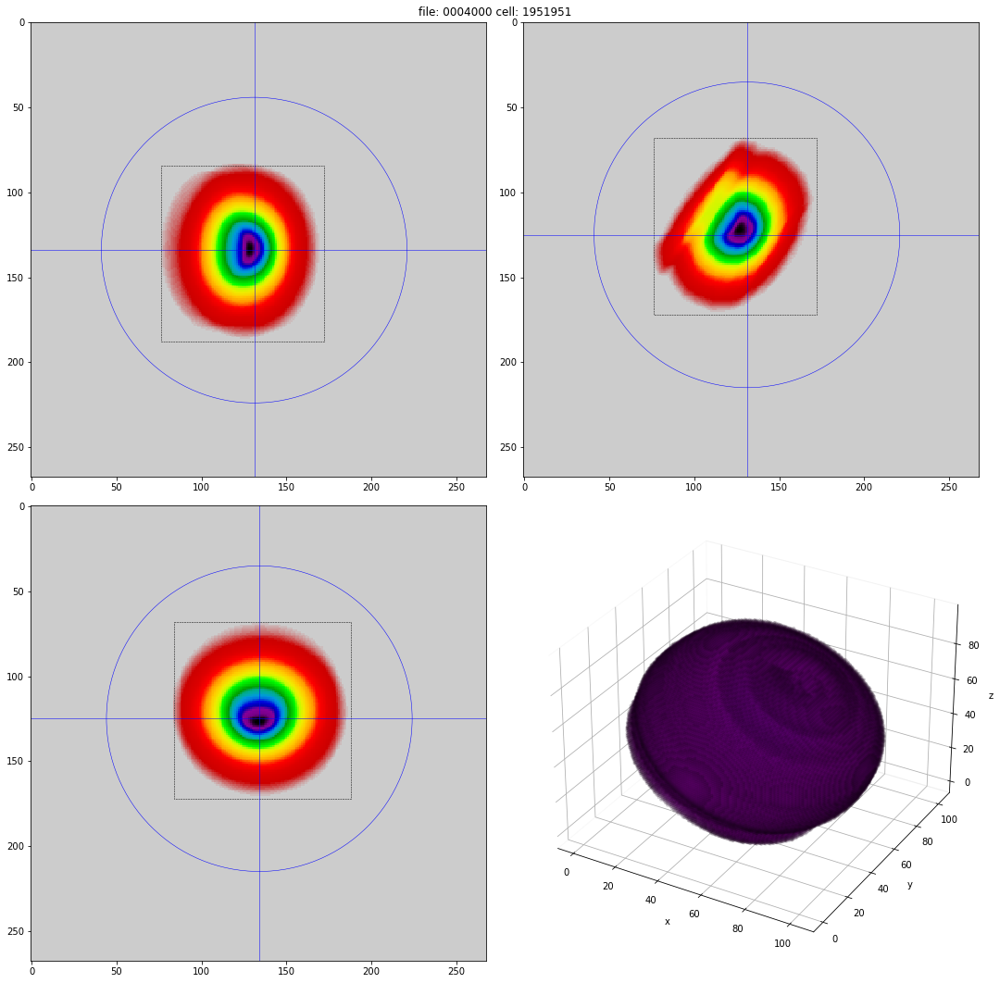

...

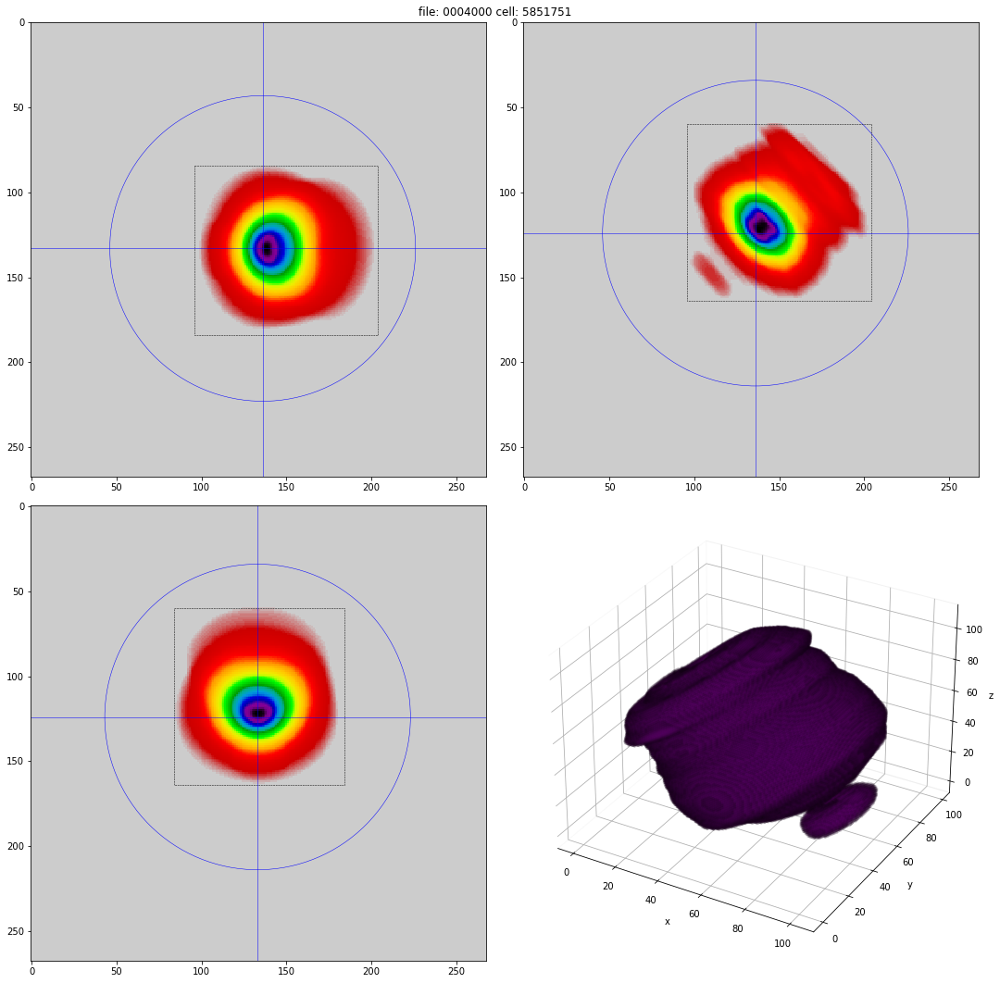

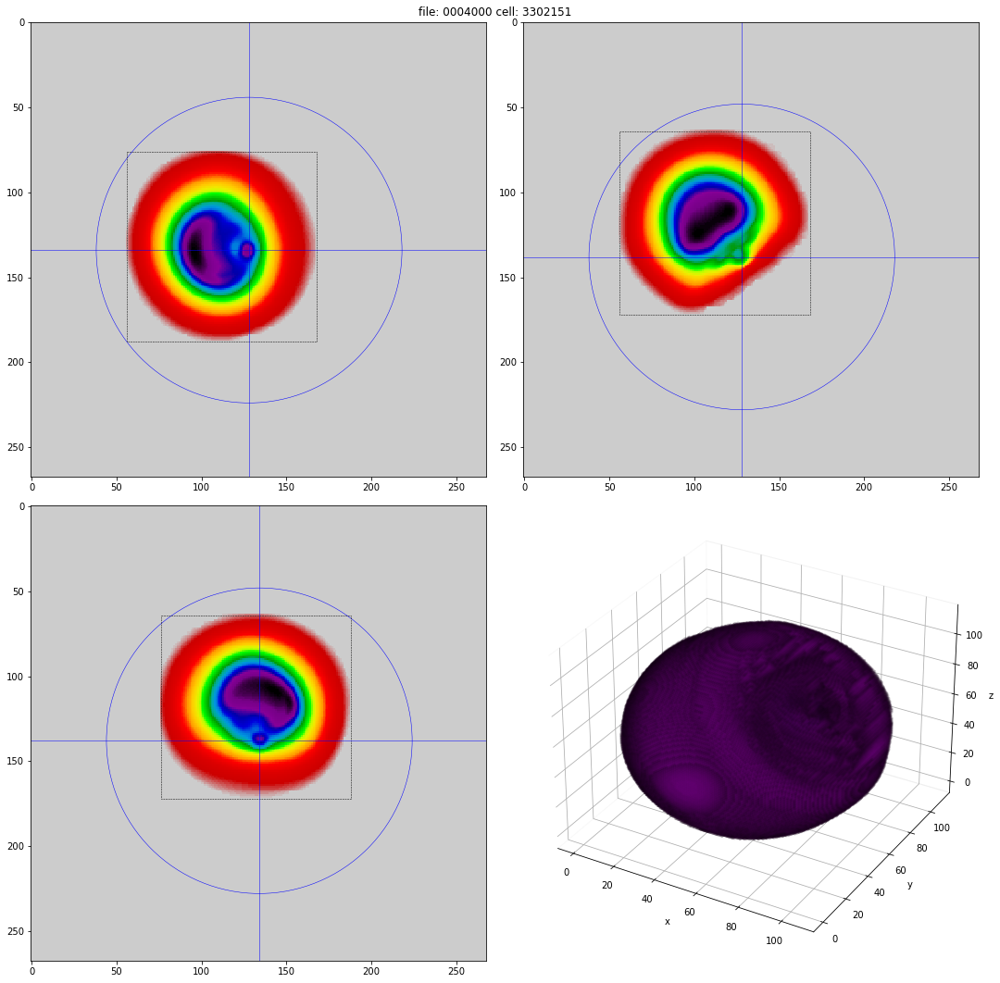

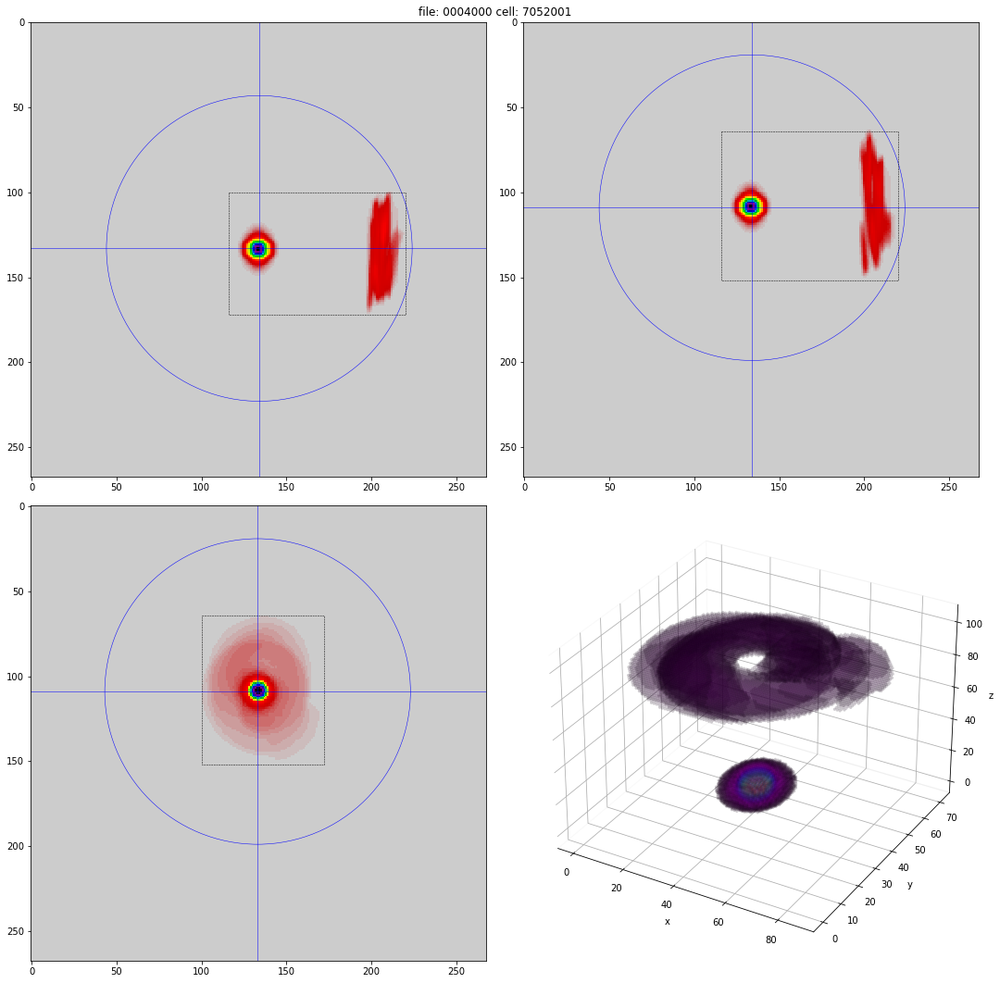

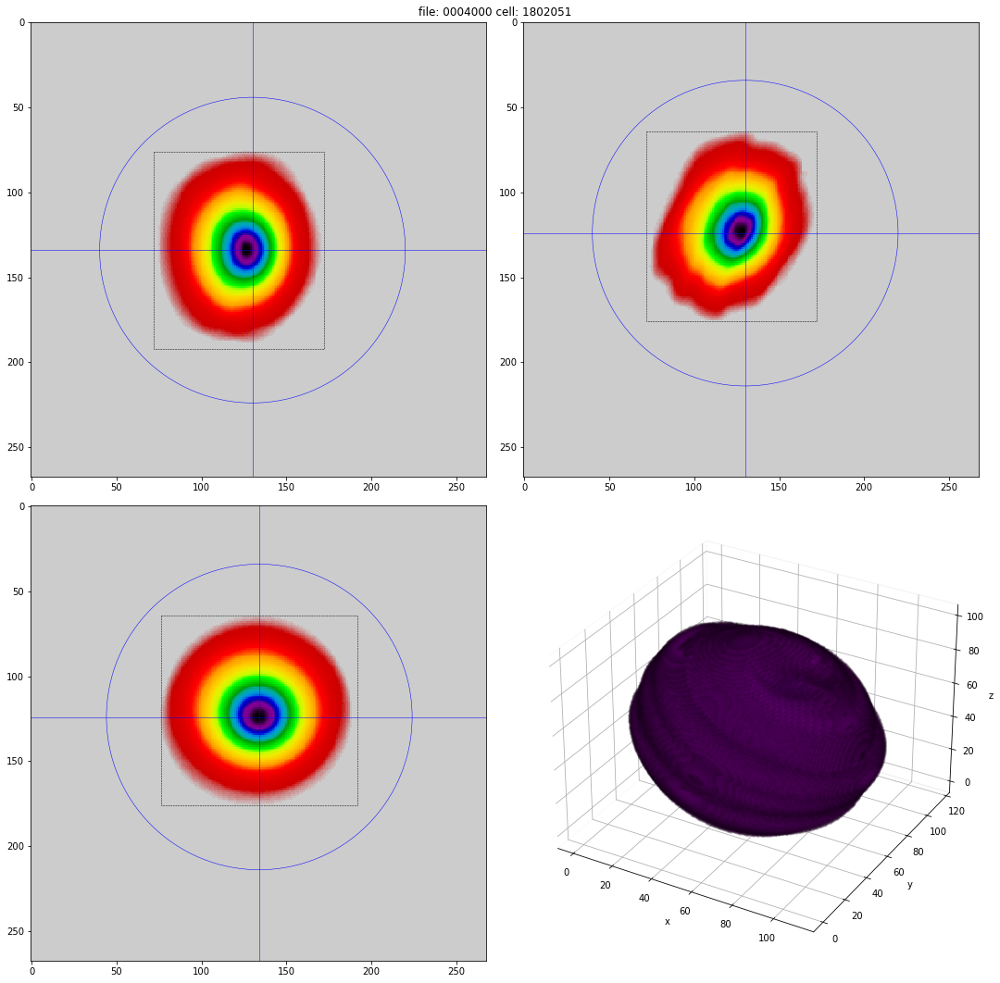

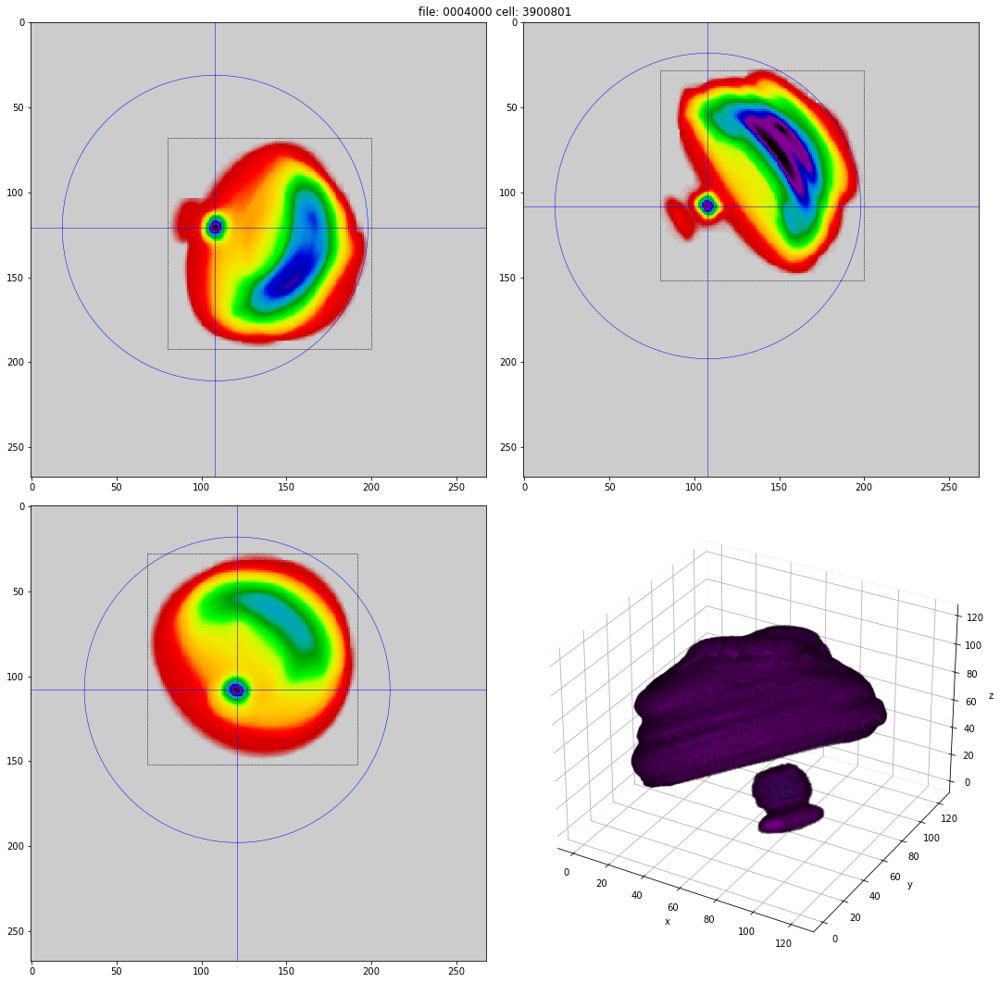

In [14]:
for n_clusters, centroids in centroid_vals.items():
    prototype_cellids = find_prototype_cells(df_scaled['cellid'].values,
                                            df_scaled[features].values,
                                            centroid_vals[n_clusters])
    df_vdf = df_scaled[df_scaled['cellid'].isin(f.vdfcellids)]
    vdf_prototype_cellids = find_prototype_cells(df_vdf['cellid'].values,
                                                df_vdf[features].values,
                                                centroid_vals[n_clusters])
    for i, cellid in enumerate(vdf_prototype_cellids):
        fig = vdfplot.vdf_overview(f.get_vdf(cellid))
        fig.savefig(f'../output/2D_magnetosphere/images/kmeans/{n_clusters}class/characteristic_vdf/cluster{i+1}_prototype.png')
        plt.close(fig)

In [15]:
#prototype_cellids = find_prototype_cells(df_scaled['cellid'].values,
#                                         df_scaled[features].values,
#                                         centroid_vals[7])

In [16]:
#df_vdf = df_scaled[df_scaled['cellid'].isin(f.vdfcellids)]
#vdf_prototype_cellids = find_prototype_cells(df_vdf['cellid'].values,
#                                             df_vdf[features].values,
#                                             centroid_vals[7])


In [17]:
#for i, cellid in enumerate(vdf_prototype_cellids):
#    fig = vdfplot.vdf_overview(f.get_vdf(cellid))
#    fig.savefig(f'../output/kmeans_7class_prototype_{i+1}.png')

In [18]:
def get_image_coords(cellid):
    x, y = np.argwhere(f.spatial_mesh.cellid_matrix.squeeze() == cellid).flatten()
    return x, y

In [19]:
def highlight_cluster(image, cellid, color=(200, 200, 200)):
    color = np.array(color)
    image = image.copy()
    x, y = get_image_coords(cellid)
    clustercolor = image[x, y]
    mask = (image == clustercolor).all(axis=2)
    image[mask] = np.array([200, 200, 200])
    image[y, x, :] = color
    image[~mask] //= 6  # dim rest of image
    return image

In [39]:
def draw_marker(image, cellid, color=(255, 0, 0)):
    image = image.copy()
    x, y = np.argwhere(f.spatial_mesh.cellid_matrix.squeeze() == cellid).flatten()
    marker = skimage.draw.disk((x, y), 20)
    marker[0][marker[0] >= image.shape[0]] = image.shape[0]-1
    marker[1][marker[1] >= image.shape[1]] = image.shape[1]-1
    image[marker] = color
    return image

In [41]:
for n_clusters, image in images.items():
    prototype_cellids = find_prototype_cells(df_scaled['cellid'].values,
                                             df_scaled[features].values,
                                             centroid_vals[n_clusters])

    df_vdf = df_scaled[df_scaled['cellid'].isin(f.vdfcellids)]
    vdf_prototype_cellids = find_prototype_cells(df_vdf['cellid'].values,
                                                df_vdf[features].values,
                                                centroid_vals[n_clusters])

    for i in range(len(prototype_cellids)):
        if os.path.exists(f'../output/2D_magnetosphere/images/kmeans/{n_clusters}class/cluster{i+1}_highlighted.png'):
            continue
        image = images[n_clusters]
        image = highlight_cluster(image, cellid=prototype_cellids[i])
        image = draw_marker(image, cellid=vdf_prototype_cellids[i])
        image = draw_marker(image, cellid=prototype_cellids[i], color=(0, 255, 0))
        plt.imshow(image)
        skimage.io.imsave(f'../output/2D_magnetosphere/images/kmeans/{n_clusters}class/cluster{i+1}_highlighted.png', image)
        plt.close()

In [43]:
for n_clusters in images.keys():
    for cluster in range(1, n_clusters+1):
        spatial_img = plt.imread(f'../output/2D_magnetosphere/images/kmeans/{n_clusters}class/cluster{cluster}_highlighted.png')
        vdf_img = plt.imread(f'../output/2D_magnetosphere/images/kmeans/{n_clusters}class/characteristic_vdf/cluster{cluster}_prototype.png')
        fig, ax = plt.subplots(1, 2, figsize=(10, 4))
        ax = ax.flatten()
        ax[0].imshow(spatial_img)
        ax[1].imshow(vdf_img)
        plt.suptitle(f'Cluster {cluster}/{n_clusters}')
        _ = plt.savefig(f'../output/2D_magnetosphere/images/kmeans/{n_clusters}class/cluster{cluster}_overview.png', dpi=150)
        plt.close(fig)